In [1]:
# import modules (9)
import os
import glob
import numpy as np
import random
import nibabel as nib
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from tifffile import imsave
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.utils import to_categorical

In [2]:
scaler = MinMaxScaler()    # store the minmaxscalar in scalar vqriable
TRAIN_DATASET_PATH = 'BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/'

In [3]:
test_image_flair=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_350/BraTS20_Training_350_flair.nii').get_fdata()
print(test_image_flair.max())
#Scalers are applied to 1D so let us reshape and then reshape back to original shape. 
test_image_flair=scaler.fit_transform(test_image_flair.reshape(-1, test_image_flair.shape[-1])).reshape(test_image_flair.shape)

test_image_t1=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_350/BraTS20_Training_350_t1.nii').get_fdata()
test_image_t1=scaler.fit_transform(test_image_t1.reshape(-1, test_image_t1.shape[-1])).reshape(test_image_t1.shape)

test_image_t1ce=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_350/BraTS20_Training_350_t1ce.nii').get_fdata()
test_image_t1ce=scaler.fit_transform(test_image_t1ce.reshape(-1, test_image_t1ce.shape[-1])).reshape(test_image_t1ce.shape)

test_image_t2=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_350/BraTS20_Training_350_t2.nii').get_fdata()
test_image_t2=scaler.fit_transform(test_image_t2.reshape(-1, test_image_t2.shape[-1])).reshape(test_image_t2.shape)

test_mask=nib.load(TRAIN_DATASET_PATH + 'BraTS20_Training_350/BraTS20_Training_350_seg.nii').get_fdata()
test_mask=test_mask.astype(np.uint8)




2348.0


In [4]:
print(np.unique(test_mask))

[0 1 2 4]


In [5]:
test_mask[test_mask==4] = 3
print(np.unique(test_mask))

[0 1 2 3]


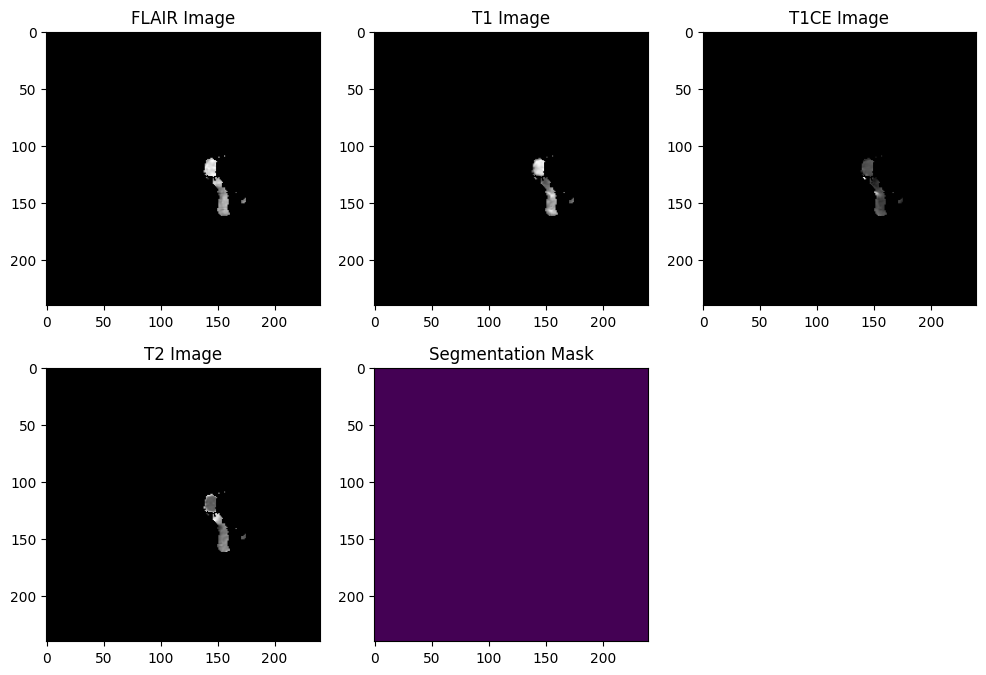

In [6]:
# Set up the figure and the axes
fig, axs = plt.subplots(2, 3, figsize=(12, 8))

def update(frame):
    # Update each subplot with the new slice
    axs[0, 0].clear()
    axs[0, 0].imshow(test_image_flair[:, :, frame], cmap='gray')
    axs[0, 0].set_title('FLAIR Image')
    
    axs[0, 1].clear()
    axs[0, 1].imshow(test_image_t1[:, :, frame], cmap='gray')
    axs[0, 1].set_title('T1 Image')
    
    axs[0, 2].clear()
    axs[0, 2].imshow(test_image_t1ce[:, :, frame], cmap='gray')
    axs[0, 2].set_title('T1CE Image')
    
    axs[1, 0].clear()
    axs[1, 0].imshow(test_image_t2[:, :, frame], cmap='gray')
    axs[1, 0].set_title('T2 Image')
    
    axs[1, 1].clear()
    axs[1, 1].imshow(test_mask[:, :, frame])
    axs[1, 1].set_title('Segmentation Mask')

    # Clear the last subplot space or put another image here
    axs[1, 2].clear()
    axs[1, 2].axis('off')

# Get the total number of slices from one of the modalities
total_slices = test_image_flair.shape[2]

# Create the animation
ani = FuncAnimation(fig, update, frames=total_slices, repeat=True)

# Display the animation
HTML(ani.to_jshtml())

In [7]:
combined_x = np.stack([test_image_flair, test_image_t1ce, test_image_t2], axis=3)

In [8]:
combined_x=combined_x[56:184, 56:184, 13:141] #Crop to 128x128x128x4

In [9]:
#Do the same for mask
test_mask = test_mask[56:184, 56:184, 13:141]

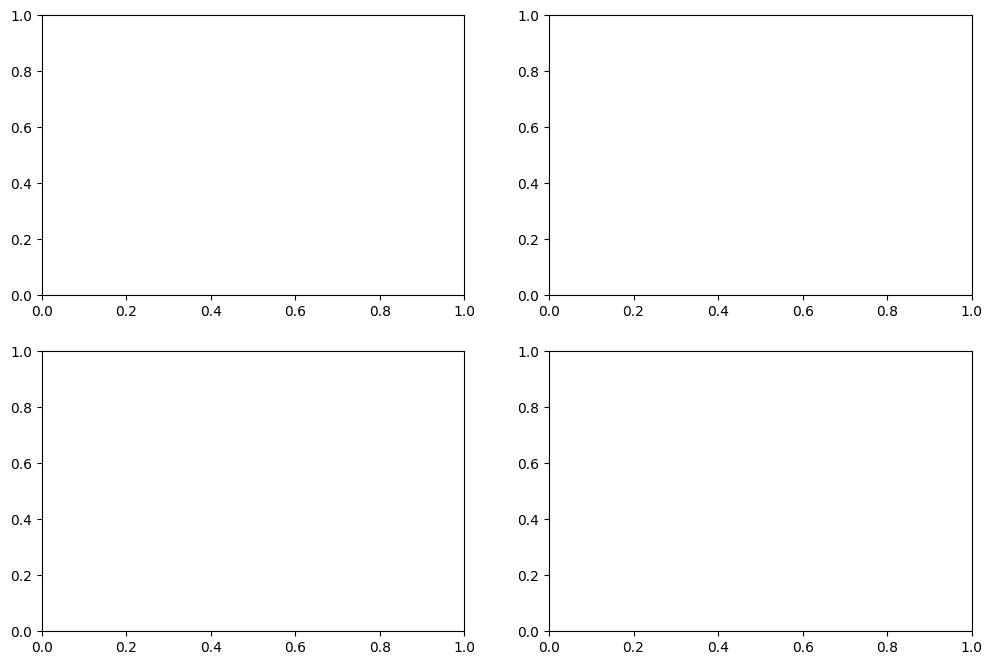

In [10]:
fig, axs = plt.subplots(2, 2, figsize=(12, 8))


In [11]:
def update(frame):
    # Clear existing content in subplots
    axs[0, 0].clear()
    axs[0, 1].clear()
    axs[1, 0].clear()
    axs[1, 1].clear()
    
    # Update images for each subplot based on the current frame index
    axs[0, 0].imshow(combined_x[:, :, frame, 0], cmap='gray')
    axs[0, 0].set_title('FLAIR Image')
    
    axs[0, 1].imshow(combined_x[:, :, frame, 1], cmap='gray')
    axs[0, 1].set_title('T1CE Image')
    
    axs[1, 0].imshow(combined_x[:, :, frame, 2], cmap='gray')
    axs[1, 0].set_title('T2 Image')
    
    axs[1, 1].imshow(test_mask[:, :, frame])
    axs[1, 1].set_title('Segmentation Mask')


In [12]:
# Get the total number of slices from one of the modalities
total_slices = combined_x.shape[2]

# Create the animation
ani = FuncAnimation(fig, update, frames=total_slices, repeat=True)


In [13]:
HTML(ani.to_jshtml())


Animation size has reached 21179395 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [15]:
from tifffile import imwrite

In [16]:
imwrite('BraTS2020_TrainingData/combined255.tif', combined_x)
np.save('BraTS2020_TrainingData/combined255.npy', combined_x)
#Verify image is being read properly
#my_img=imread('BraTS2020_TrainingData/combined255.tif')

my_img=np.load('BraTS2020_TrainingData/combined255.npy')


In [17]:
test_mask = to_categorical(test_mask, num_classes=4)


In [18]:
t2_list = sorted(glob.glob('BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/*/*t2.nii'))
t1ce_list = sorted(glob.glob('BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/*/*t1ce.nii'))
flair_list = sorted(glob.glob('BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/*/*flair.nii'))
mask_list = sorted(glob.glob('BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/*/*seg.nii'))

In [20]:
for img in range(len(t2_list)):   #Using t1_list as all lists are of same size
    print("Now preparing image and masks number: ", img)
      
    temp_image_t2=nib.load(t2_list[img]).get_fdata()
    temp_image_t2=scaler.fit_transform(temp_image_t2.reshape(-1, temp_image_t2.shape[-1])).reshape(temp_image_t2.shape)
   
    temp_image_t1ce=nib.load(t1ce_list[img]).get_fdata()
    temp_image_t1ce=scaler.fit_transform(temp_image_t1ce.reshape(-1, temp_image_t1ce.shape[-1])).reshape(temp_image_t1ce.shape)
   
    temp_image_flair=nib.load(flair_list[img]).get_fdata()
    temp_image_flair=scaler.fit_transform(temp_image_flair.reshape(-1, temp_image_flair.shape[-1])).reshape(temp_image_flair.shape)
        
    temp_mask=nib.load(mask_list[img]).get_fdata()
    temp_mask=temp_mask.astype(np.uint8)
    temp_mask[temp_mask==4] = 3  #Reassign mask values 4 to 3
    #print(np.unique(temp_mask))
    
    
    temp_combined_images = np.stack([temp_image_flair, temp_image_t1ce, temp_image_t2], axis=3)
    
    #Crop to a size to be divisible by 64 so we can later extract 64x64x64 patches. 
    #cropping x, y, and z
    temp_combined_images=temp_combined_images[56:184, 56:184, 13:141]
    temp_mask = temp_mask[56:184, 56:184, 13:141]
    
    val, counts = np.unique(temp_mask, return_counts=True)
    
    if (1 - (counts[0]/counts.sum())) > 0.01:  #At least 1% useful volume with labels that are not 0
        print("Save Me")
        temp_mask= to_categorical(temp_mask, num_classes=4)
        np.save('BraTS2020_TrainingData/input_data_3channels/images/image_'+str(img)+'.npy', temp_combined_images)
        np.save('BraTS2020_TrainingData/input_data_3channels/masks/mask_'+str(img)+'.npy', temp_mask)
        
    else:
        print("I am useless")   
   



Now preparing image and masks number:  0
Save Me
Now preparing image and masks number:  1
Save Me
Now preparing image and masks number:  2
Save Me
Now preparing image and masks number:  3
Save Me
Now preparing image and masks number:  4
I am useless
Now preparing image and masks number:  5
Save Me
Now preparing image and masks number:  6
Save Me
Now preparing image and masks number:  7
Save Me
Now preparing image and masks number:  8
Save Me
Now preparing image and masks number:  9
Save Me
Now preparing image and masks number:  10
Save Me
Now preparing image and masks number:  11
Save Me
Now preparing image and masks number:  12
Save Me
Now preparing image and masks number:  13
Save Me
Now preparing image and masks number:  14
Save Me
Now preparing image and masks number:  15
Save Me
Now preparing image and masks number:  16
Save Me
Now preparing image and masks number:  17
Save Me
Now preparing image and masks number:  18
Save Me
Now preparing image and masks number:  19
Save Me
Now p

In [21]:
import splitfolders  

input_folder = 'BraTS2020_TrainingData/input_data_3channels/'
output_folder = 'BraTS2020_TrainingData/input_data_128/'
# Split with a ratio.
# To only split into training and validation set, set a tuple to `ratio`, i.e, `(.8, .2)`.
splitfolders.ratio(input_folder, output=output_folder, seed=42, ratio=(.75, .25), group_prefix=None) # default values
